### Code needed to import files inside drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

import sys
sys.path.insert(0, '/content/drive/MyDrive/progetto lab AI/tesi/unet')
sys.path.insert(0, '/content/drive/MyDrive/progetto lab AI/tesi/siamunet')

%matplotlib inline
from LEVIR_Loader import get
from unet import unet
from siamunet_diff import SiamUnet_diff

train_loader, val_loader, test_loader = get("drive/MyDrive/progetto lab AI/LEVIR-CD+", 1)

Mounted at /content/drive
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Found 637 samples in drive/MyDrive/progetto lab AI/LEVIR-CD+/train
Found 129 samples in drive/MyDrive/progetto lab AI/LEVIR-CD+/val
Found 219 samples in drive/MyDrive/progetto lab AI/LEVIR-CD+/test


### Import checkpoints

In [2]:
from torch.optim import Adam
import torch

## Load unet checkpoint
PATH = "drive/MyDrive/progetto lab AI/tesi/unet/saves/save_best_f1.pt"

net = unet()
net.cuda()

checkpoint = torch.load(PATH)
net.load_state_dict(checkpoint['model_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']

print("Loaded UNET checkpoint at epoch:", epoch, ", loss:", loss)

## Load SiamUnet_diff
PATH = "drive/MyDrive/progetto lab AI/tesi/siamunet/saves/save_best_f1.pt"

siamnet = SiamUnet_diff(3, 2)
siamnet.cuda()

checkpoint = torch.load(PATH)
siamnet.load_state_dict(checkpoint['model_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']

print("Loaded SiamUnet diff checkpoint at epoch:", epoch, ", loss:", loss)

Loaded UNET checkpoint at epoch: 27 , loss: 0.03680931776762009
Loaded SiamUnet diff checkpoint at epoch: 28 , loss: 0.07428627461194992


# Test

In [3]:
!pip install torchmetrics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.2/805.2 kB 12.3 MB/s eta 0:00:00


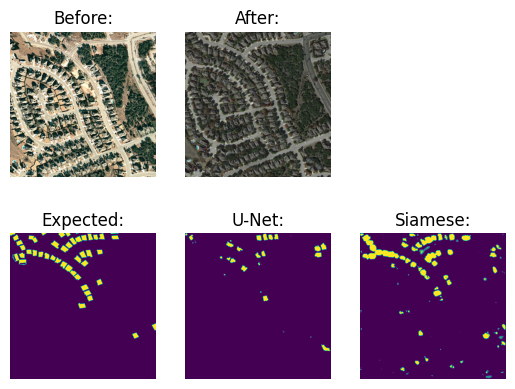

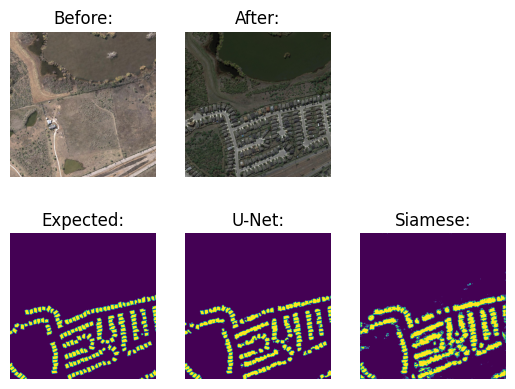

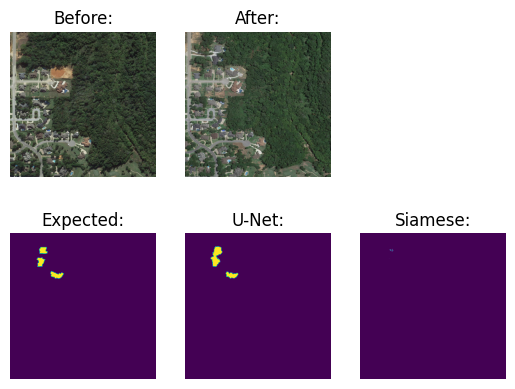

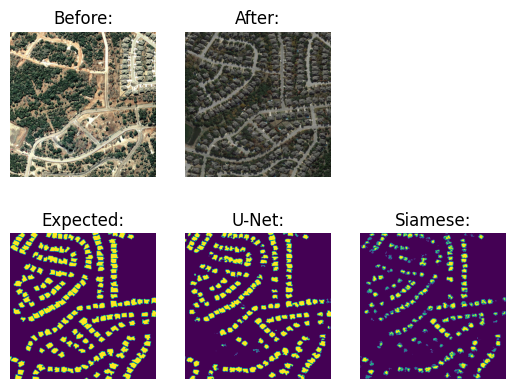

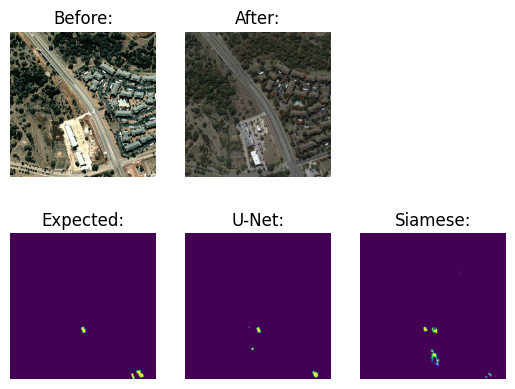

...

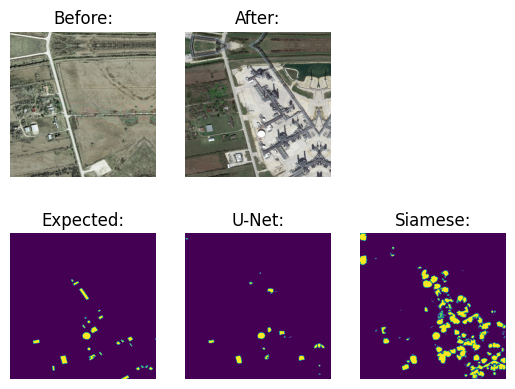

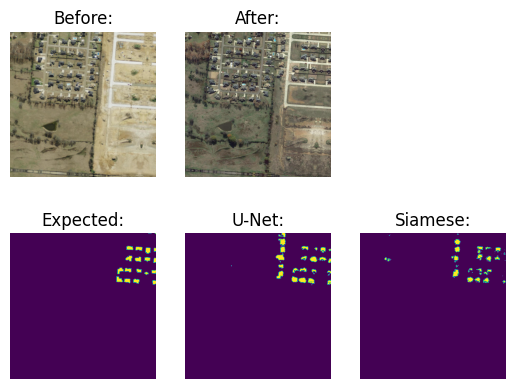

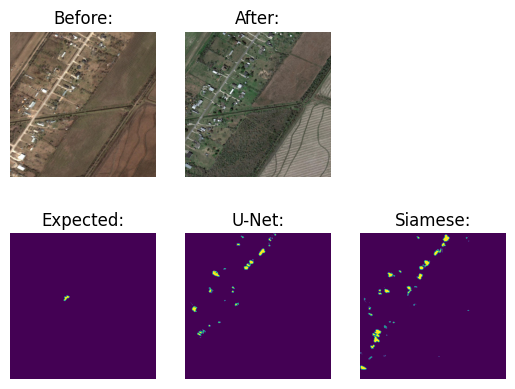

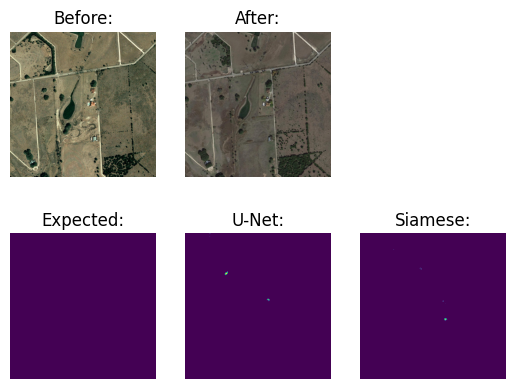

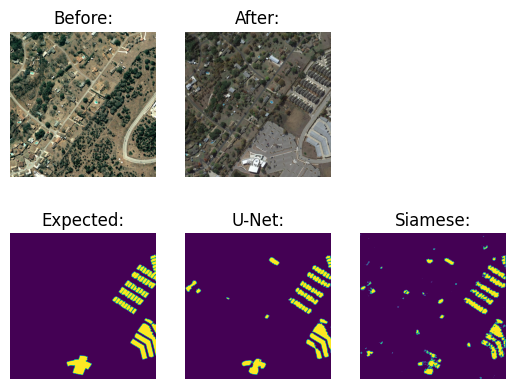


Accuracy   Precision   Recall   f1-score

Unet:
97.72%     57.64%     48.59%    49.10%
Siam:
96.96%     48.86%     38.99%    37.05%


In [10]:
import matplotlib.pyplot as plt

from torchmetrics.classification import BinaryRecall, BinaryPrecision, BinaryF1Score, BinaryAccuracy

recall_metric = BinaryRecall()
precision_metric = BinaryPrecision()
f1_metric = BinaryF1Score()
acc_metric = BinaryAccuracy()

recall_metric = recall_metric.cuda()
precision_metric = precision_metric.cuda()
f1_metric = f1_metric.cuda()
acc_metric.cuda()

recall_tot_unet = 0
precision_tot_unet = 0
f1_tot_unet = 0
acc_tot_unet = 0

recall_tot_siam = 0
precision_tot_siam = 0
f1_tot_siam = 0
acc_tot_siam = 0

max_iter = len(test_loader)

for batch_id, (images_A, images_B, images_label) in enumerate(test_loader):
    with torch.no_grad():
        images_label = images_label.cuda()
        out1 = net(torch.cat([images_A.cuda(), images_B.cuda()], dim=1))
        out2 = siamnet(images_A.cuda(), images_B.cuda())

        for i in range(images_A.shape[0]):
            image_A = images_A[i]  # Remove the batch dimension if not needed (1, C, H, W) to (C, H, W)
            image_B = images_B[i]
            image_label = images_label[i]

            before = plt.subplot(2, 3, 1)  # Create subplots for each image
            before.title.set_text("Before:")
            plt.imshow(image_A.numpy().transpose((1, 2, 0)))
            plt.axis('off')

            after = plt.subplot(2, 3, 2)
            after.title.set_text("After:")
            plt.imshow(image_B.numpy().transpose((1, 2, 0)))
            plt.axis('off')

            exp_fig = plt.subplot(2, 3, 4)
            exp_fig.title.set_text("Expected:")
            plt.imshow(image_label.cpu().numpy().transpose((1, 2, 0)))
            plt.axis('off')

            e = out1[i]
            pref_fig = plt.subplot(2, 3, 5)
            pref_fig.title.set_text("U-Net:")
            disc_img = e>0.5
            plt.imshow(disc_img.float().cpu().detach().numpy().transpose((1, 2, 0)))
            plt.axis('off')

            recall_tot_unet += recall_metric(disc_img, image_label)
            precision_tot_unet += precision_metric(disc_img, image_label)
            f1_tot_unet += f1_metric(disc_img, image_label)
            acc_tot_unet += acc_metric(disc_img, image_label)

            pref_fig = plt.subplot(2, 3, 6)
            pref_fig.title.set_text("Siamese:")
            disc_img = torch.argmax(out2, dim=1)
            plt.imshow(disc_img.cpu().numpy().transpose((1, 2, 0)))
            plt.axis('off')

            recall_tot_siam += recall_metric(disc_img, image_label)
            precision_tot_siam += precision_metric(disc_img, image_label)
            f1_tot_siam += f1_metric(disc_img, image_label)
            acc_tot_siam += acc_metric(disc_img, image_label)

            plt.show()
        if batch_id == max_iter-1:
            break

print()
print("Accuracy   Precision   Recall   f1-score")
print()
print("Unet:")
print(format(acc_tot_unet.item()/max_iter*100, ".2f")+"%    ", format(precision_tot_unet.item()/max_iter*100, ".2f")+"%    ", format(recall_tot_unet.item()/max_iter*100, ".2f")+"%   ", format(f1_tot_unet.item()/max_iter*100, ".2f")+"%")
print("Siam:")
print(format(acc_tot_siam.item()/max_iter*100, ".2f")+"%    ", format(precision_tot_siam.item()/max_iter*100, ".2f")+"%    ", format(recall_tot_siam.item()/max_iter*100, ".2f")+"%   ", format(f1_tot_siam.item()/max_iter*100, ".2f")+"%")